In [25]:
## importing some useful packages
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

In [26]:
# more globals for testing images
filename = 'vehicles/GTI_Far/image0010.png'
trafficfile = 'test_images/test1.jpg'

###############################################
### convert BGR to RGB for the video mage
def read_png(filename):
    ximage = cv2.imread(filename)
    rgb_image = cv2.cvtColor(ximage, cv2.COLOR_BGR2RGB)
    return rgb_image
    

In [27]:

# check test images type and shape
def image_shape(filename):
    image = mpimg.imread(filename)
    print (filename, ' shape is: ', image.shape)
##    print (image)

In [28]:
################################
# define global functions and variables
def def_global():
# pixel spatial and histogram
    global spatial_size, spatial, histbin, hist_bins, orient, pix_per_cell, cell_per_block
    global cells_per_block, hog_channel, spatial_feat, hist_feat, hog_feat, y_start_stop, overlap
    global color_space, xywindow, threshold
 # color and shape    
    spatial_size = (32,32)
    spatial = 32
    histbin = 32
    hist_bins = histbin # Number of histogram bins
# HOG
    orient = 12  # or 12 play with it
    pix_per_cell = 8
    cell_per_block = 2 # 
    cells_per_block = (cell_per_block, cell_per_block)
    hog_channel = 'ALL' # Can be 0, 1, 2, or "ALL"
    
    spatial_feat = False # Spatial features on or off
    hist_feat = False # Histogram features on or off
    hog_feat = True # HOG features on or off
### dlo y_start_stop = [None, None] # Min and max in y to search in slide_window()
    y_start_stop = [368, 720] # Min and max in y to search in slide_window()
    overlap = (0.5,0.5)
    color_space = 'YCrCb'
    xywindow = (88, 88)
    threshold = 1

In [29]:
#########################################
# build the arrray to hold training and testing images
def get_car_list():
    import glob
#from skimage.feature import hog
#from skimage import color, exposure
# images are divided up into vehicles and non-vehicles
    global cars, notcars
    cars = []
    notcars = []

## images = glob.glob('*.jpeg')
### dlo 3/5/17 images = glob.glob('vehicles_smallset/*/*.jpeg')
    images = glob.glob('vehicles/*/*.png')
    for image in images:
        cars.append(image)
# non-vehicles_smallset/notcars1
### dlo 3//17 images = glob.glob('non-vehicles_smallset/*/*.jpeg')
    images = glob.glob('non-vehicles/*/*.png')
    for image in images:
        notcars.append(image)
        
get_car_list() 

In [31]:
#. print ('spatial_size',spatial_size)
def show_global():
    print ('*** global parameters\n')
    print ('spatial_size',spatial_size)
    print ('pix_per_cell', pix_per_cell)
    print ('spatial', spatial)
    print ('histbin', histbin)
    print ('hist_bins', hist_bins)
    print ('orient',orient)
    print ('cell_per_block', cell_per_block)
#    print ('pix_per_cell', pix_per_cell)
    print ('hog_channel',hog_channel)
    print ('spatial_feat',spatial_feat)
    print ('hist_feat', hist_feat)
    print ('hog_feat', hog_feat)
    print ('y_start_stop',y_start_stop)
    print ('overlap', overlap)
    print ('color_space', color_space)
    print ('xywindow', xywindow)
    print ('threshold', threshold)
    print ('len(cars)', len(cars))
    print ('{len(notcars)}', len(notcars), '\n')
def_global()
show_global()

*** global parameters

spatial_size (32, 32)
pix_per_cell 8
spatial 32
histbin 32
hist_bins 32
orient 12
cell_per_block 2
hog_channel ALL
spatial_feat False
hist_feat False
hog_feat True
y_start_stop [368, 720]
overlap (0.5, 0.5)
color_space YCrCb
xywindow (88, 88)
threshold 1
len(cars) 8792
{len(notcars)} 8968 



In [32]:
# functions used during car ID and tracking
#################################################
### find cars  in an test or video image
def find_cars(image):
    ## dlo image = mpimg.imread('bbox-example-image.jpg')
##    image = mpimg.imread(trafficfile)
    draw_image = np.copy(image)

# Uncomment the following line if you extracted training
# data from .png images (scaled 0 to 1 by mpimg) and the
# image you are searching is a .jpg (scaled 0 to 255)
#image = image.astype(np.float32)/255

### dlo 3/7/17 use 128,128 
### windows = slide_window(image, x_start_stop=[None, None], y_start_stop=y_start_stop, 
###                    xy_window=(96, 96), xy_overlap=overlap)
    windows = slide_window(image, x_start_stop=[None, None], y_start_stop=y_start_stop, 
                    xy_window=xywindow, xy_overlap=overlap)


    print ('in find cars')

    hot_windows = search_windows(image, windows, svc, X_scaler, color_space=color_space, 
                        spatial_size=spatial_size, hist_bins=hist_bins, 
                        orient=orient, pix_per_cell=pix_per_cell, 
                        cell_per_block=cell_per_block, 
                        hog_channel=hog_channel, spatial_feat=spatial_feat, 
                        hist_feat=hist_feat, hog_feat=hog_feat)                       
    print ('in find cars after search')
    window_img = draw_boxes(draw_image, hot_windows, color=(0, 0, 255), thick=6)  
    print ('in find cars, after draw_boxes')
## print ('image shape :',window_img.shape)
## plt.imshow(window_img)

    box_list = hot_windows
    return window_img, box_list

In [33]:
## functions used for training classification (color and HOG)
#####################################################################
# Define a function to extract features from a list of images
# Have this function call bin_spatial() and color_hist()
def extract_features_color(imgs, cspace='RGB', spatial_size=(32, 32),
                        hist_bins=32, hist_range=(0, 256)):
    # Create a list to append feature vectors to
    features = []
    # Iterate through the list of images
        # Read in each one by one
        # apply color conversion if other than 'RGB'
        # Apply bin_spatial() to get spatial color features
        # Apply color_hist() to get color histogram features
        # Append the new feature vector to the features list
            # Iterate through the list of images
    for file in imgs:
        # Read in each one by one
  ### dlo 3/5/17      image = mpimg.imread(file)
        image = read_png(file)
        # apply color conversion if other than 'RGB'
        if cspace != 'RGB':
            if cspace == 'HSV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
            elif cspace == 'LUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
            elif cspace == 'HLS':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
            elif cspace == 'YUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
        else: feature_image = np.copy(image)      
        # Apply bin_spatial() to get spatial color features
        spatial_features = bin_spatial(feature_image, color_space=cspace, size=spatial_size)
        # Apply color_hist() also with a color space option now
        hist_features = color_hist(feature_image, nbins=hist_bins, bins_range=hist_range)
        # Append the new feature vector to the features list
        features.append(np.concatenate((spatial_features, hist_features)))
    # Return list of feature vectors
    return features

###################################################################################
# Define a function to extract features from a list of images
# Have this function call bin_spatial() and color_hist()
def extract_features_hog(imgs, cspace='RGB', orient=9, 
                        pix_per_cell=8, cell_per_block=2, hog_channel=0):
    # Create a list to append feature vectors to
    features = []
    # Iterate through the list of images
    for file in imgs:
        # Read in each one by one
### dlo 3/5/17
###        image = mpimg.imread(file)
        image = read_png(file)
        # apply color conversion if other than 'RGB'
        if cspace != 'RGB':
            if cspace == 'HSV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
            elif cspace == 'LUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
            elif cspace == 'HLS':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
            elif cspace == 'YUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
            elif cspace == 'YCrCb':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
        else: feature_image = np.copy(image)      

        # Call get_hog_features() with vis=False, feature_vec=True
        if hog_channel == 'ALL':
            hog_features = []
            for channel in range(feature_image.shape[2]):
                hog_features.append(get_hog_features(feature_image[:,:,channel], 
                                    orient, pix_per_cell, cell_per_block, 
                                    vis=False, feature_vec=True))
            hog_features = np.ravel(hog_features)        
        else:
            hog_features = get_hog_features(feature_image[:,:,hog_channel], orient, 
                        pix_per_cell, cell_per_block, vis=False, feature_vec=True)
        # Append the new feature vector to the features list
        features.append(hog_features)
    # Return list of feature vectors
    return features



In [34]:
## HOG functions
#####################################################################
# Define a function to return HOG features and visualization
def get_hog_features(img, orient, pix_per_cell, cell_per_block, vis=False, feature_vec=True):
    # Call with two outputs if vis==True
    if vis == True:
        features, hog_image = hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                                  cells_per_block=(cell_per_block, cell_per_block), transform_sqrt=True, 
                                  visualise=vis, feature_vector=feature_vec)
        return features, hog_image
    # Otherwise call with one output
    else:      
        features = hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block), transform_sqrt=True, 
                       visualise=vis, feature_vector=feature_vec)
        return features

Your function returned a count of 8792  cars and 8968  non-cars
of size:  (64, 64, 3)  and data type: uint8


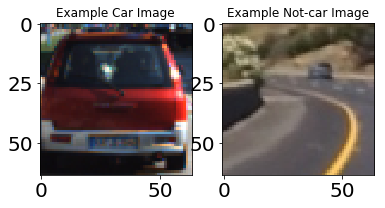

In [35]:
# #18 Data Exploration
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import cv2
import glob
#from skimage.feature import hog
#from skimage import color, exposure
# images are divided up into vehicles and non-vehicles
'''
cars = []
notcars = []

## images = glob.glob('*.jpeg')
### dlo 3/5/17 images = glob.glob('vehicles_smallset/*/*.jpeg')
images = glob.glob('vehicles/*/*.png')
for image in images:
    cars.append(image)
# non-vehicles_smallset/notcars1
### dlo 3//17 images = glob.glob('non-vehicles_smallset/*/*.jpeg')
images = glob.glob('non-vehicles/*/*.png')
for image in images:
    notcars.append(image)
'''

# Define a function to return some characteristics of the dataset 
def data_look(car_list, notcar_list):
    data_dict = {}
    # Define a key in data_dict "n_cars" and store the number of car images
    data_dict["n_cars"] = len(car_list)
    # Define a key "n_notcars" and store the number of notcar images
    data_dict["n_notcars"] = len(notcar_list)
    # Read in a test image, either car or notcar
### dlo 3/5     example_img = mpimg.imread(car_list[0])
    example_img = read_png(car_list[0])
    # Define a key "image_shape" and store the test image shape 3-tuple
    data_dict["image_shape"] = example_img.shape
    # Define a key "data_type" and store the data type of the test image.
    data_dict["data_type"] = example_img.dtype
    # Return data_dict
    return data_dict
    
data_info = data_look(cars, notcars)

print('Your function returned a count of', 
      data_info["n_cars"], ' cars and', 
      data_info["n_notcars"], ' non-cars')
print('of size: ',data_info["image_shape"], ' and data type:', 
      data_info["data_type"])
# Just for fun choose random car / not-car indices and plot example images   
car_ind = np.random.randint(0, len(cars))
notcar_ind = np.random.randint(0, len(notcars))
    
# Read in car / not-car images
## image = read_png(filename)
car_image = read_png(cars[car_ind])
notcar_image = read_png(notcars[notcar_ind])

### car_image = mpimg.imread(cars[car_ind])
### notcar_image = mpimg.imread(notcars[notcar_ind])


# Plot the examples
fig = plt.figure()
plt.subplot(121)
plt.imshow(car_image)
plt.title('Example Car Image')
plt.subplot(122)
plt.imshow(notcar_image)
plt.title('Example Not-car Image')


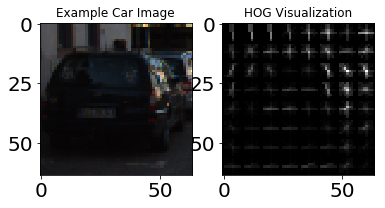

In [36]:
# Lesspn 19, HOG from scikit-image
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import cv2
import glob
from skimage.feature import hog

# Generate a random index to look at a car image
ind = np.random.randint(0, len(cars))
# Read in the image
### dlo 3/5/17
### image = mpimg.imread(cars[ind])
image = read_png(cars[ind])
gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
def_global()
# Call our function with vis=True to see an image output
features, hog_image = get_hog_features(gray, orient, 
                        pix_per_cell, cell_per_block, 
                        vis=True, feature_vec=False)


# Plot the examples
fig = plt.figure()
plt.subplot(121)
plt.imshow(image, cmap='gray')
plt.title('Example Car Image')
plt.subplot(122)
plt.imshow(hog_image, cmap='gray')
plt.title('HOG Visualization')

*** global parameters

spatial_size (32, 32)
pix_per_cell 8
spatial 32
histbin 32
hist_bins 32
orient 12
cell_per_block 2
hog_channel ALL
spatial_feat False
hist_feat False
hog_feat True
y_start_stop [368, 720]
overlap (0.5, 0.5)
color_space YCrCb
xywindow (88, 88)
threshold 1
len(cars) 8792
{len(notcars)} 8968 

Extracting and normalize feature based on hog


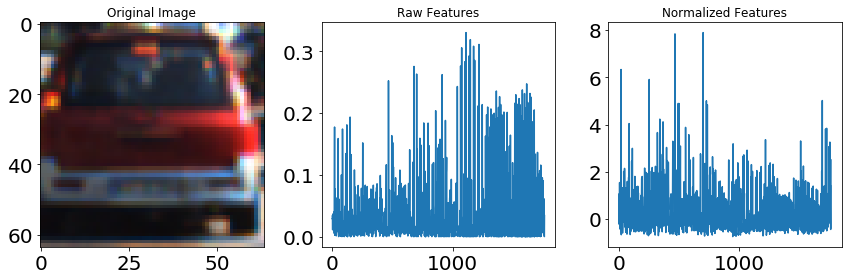

In [37]:
# lessson 21 combine features and normalize 
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from sklearn.preprocessing import StandardScaler,  RobustScaler
import glob
from skimage.feature import hog

def_global()
show_global()

print ('Extracting and normalize feature based on hog')
car_features = extract_features_hog(cars, cspace=color_space)
notcar_features = extract_features_hog(notcars, cspace=color_space)

if len(car_features) > 0:
    # Create an array stack of feature vectors
    X = np.vstack((car_features, notcar_features)).astype(np.float64)                        
    # Fit a per-column scaler
    X_scaler = RobustScaler().fit(X)
    # Normalize the values - Apply the scaler to X 
    scaled_X = X_scaler.transform(X)
    car_ind = np.random.randint(0, len(cars))
    # Plot an example of raw and scaled features
    fig = plt.figure(figsize=(12,4))
    plt.subplot(131)
### dlo 3/5/17    plt.imshow(mpimg.imread(cars[car_ind]))
    plt.imshow(read_png(cars[car_ind]))
    plt.title('Original Image')
    plt.subplot(132)
    plt.plot(X[car_ind])
    plt.title('Raw Features')
    plt.subplot(133)
    plt.plot(scaled_X[car_ind])
    plt.title('Normalized Features')
    fig.tight_layout()
else: 
    print('Your function only returns empty feature vectors...')

In [38]:
# functions used during searching of cars in image/video
#. Define a function you will pass an image
# and the list of windows to be searched (output of slide_windows())
####################################################
def search_windows(img, windows, clf, scaler, color_space='RGB', 
                    spatial_size=(32, 32), hist_bins=32, 
                    hist_range=(0, 256), orient=9, 
                    pix_per_cell=8, cell_per_block=2, 
                    hog_channel=0, spatial_feat=True, 
                    hist_feat=True, hog_feat=True):

    #1) Create an empty list to receive positive detection windows
    on_windows = []
    #2) Iterate over all windows in the list
    for window in windows:
        #3) Extract the test window from original image
        test_img = cv2.resize(img[window[0][1]:window[1][1], window[0][0]:window[1][0]], (64, 64))      
        #4) Extract features for that window using single_img_features()
        features = single_img_features(test_img, color_space=color_space, 
                            spatial_size=spatial_size, hist_bins=hist_bins, 
                            orient=orient, pix_per_cell=pix_per_cell, 
                            cell_per_block=cell_per_block, 
                            hog_channel=hog_channel, spatial_feat=spatial_feat, 
                            hist_feat=hist_feat, hog_feat=hog_feat)
        #5) Scale extracted features to be fed to classifier
        test_features = scaler.transform(np.array(features).reshape(1, -1))
        #6) Predict using your classifier
        prediction = clf.predict(test_features)
        #7) If positive (prediction == 1) then save the window
        if prediction == 1:
            on_windows.append(window)
    #8) Return windows for positive detections
    return on_windows

###########################################################
# Define a function that takes an image,
# start and stop positions in both x and y, 
# window size (x and y dimensions),  
# and overlap fraction (for both x and y)
def slide_window(img, x_start_stop=[None, None], y_start_stop=[None, None], 
                    xy_window=xywindow, xy_overlap=(0.5, 0.5)):
    # If x and/or y start/stop positions not defined, set to image size
    # Compute the span of the region to be searched    
    # Compute the number of pixels per step in x/y
    # Compute the number of windows in x/y
    # Initialize a list to append window positions to
    window_list = []
    # Loop through finding x and y window positions
    #     Note: you could vectorize this step, but in practice
    #     you'll be considering windows one by one with your
    #     classifier, so looping makes sense
        # Calculate each window position
        # Append window position to list
            # If x and/or y start/stop positions not defined, set to image size
    if x_start_stop[0] == None:
        x_start_stop[0] = 0
    if x_start_stop[1] == None:
        x_start_stop[1] = img.shape[1]
    if y_start_stop[0] == None:
        y_start_stop[0] = 0
    if y_start_stop[1] == None:
        y_start_stop[1] = img.shape[0]
    # Compute the span of the region to be searched    
    xspan = x_start_stop[1] - x_start_stop[0]
    yspan = y_start_stop[1] - y_start_stop[0]
    # Compute the number of pixels per step in x/y
    nx_pix_per_step = np.int(xy_window[0]*(1 - xy_overlap[0]))
    ny_pix_per_step = np.int(xy_window[1]*(1 - xy_overlap[1]))
    # Compute the number of windows in x/y
    nx_buffer = np.int(xy_window[0]*(xy_overlap[0]))
    ny_buffer = np.int(xy_window[1]*(xy_overlap[1]))
    nx_windows = np.int((xspan-nx_buffer)/nx_pix_per_step) 
    ny_windows = np.int((yspan-ny_buffer)/ny_pix_per_step) 
    # Initialize a list to append window positions to
    window_list = []
    # Loop through finding x and y window positions
    # Note: you could vectorize this step, but in practice
    # you'll be considering windows one by one with your
    # classifier, so looping makes sense
    for ys in range(ny_windows):
        for xs in range(nx_windows):
            # Calculate window position
            startx = xs*nx_pix_per_step + x_start_stop[0]
            endx = startx + xy_window[0]
            starty = ys*ny_pix_per_step + y_start_stop[0]
            endy = starty + xy_window[1]
            # Append window position to list
            window_list.append(((startx, starty), (endx, endy)))
    # Return the list of windows
    return window_list


#################################################################
# Define a function to extract features from a single image window
# This function is very similar to extract_features()
# just for a single image rather than list of images
#######################################################################

# Here is your draw_boxes function from the previous exercise
def draw_boxes(img, bboxes, color=(0, 0, 255), thick=6):
    # Make a copy of the image
    imcopy = np.copy(img)
    # Iterate through the bounding boxes
    for bbox in bboxes:
        # Draw a rectangle given bbox coordinates
        cv2.rectangle(imcopy, bbox[0], bbox[1], color, thick)
    # Return the image copy with boxes drawn
    return imcopy

Visualize the grid search in an image


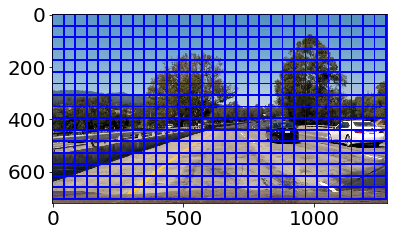

In [39]:
print ('Visualize the grid search in an image')
## svc_pickle = pickle.load( open( "output_images/csvc.p", "rb" ) )
## svc = svc_pickle["svc"]
## X_scaler = svc_pickle["scaler"]
image = mpimg.imread(trafficfile)
windows = slide_window(image, x_start_stop=[None, None], y_start_stop=[None, None], 
                    xy_window=xywindow, xy_overlap=(0.5, 0.5))
                       
window_img = draw_boxes(image, windows, color=(0, 0, 255), thick=6)                    
plt.imshow(window_img)

In [40]:
# Define a function to extract features from a single image window
# This function is very similar to extract_features()
# just for a single image rather than list of images
def single_img_features(img, color_space='RGB', spatial_size=(32, 32),
                        hist_bins=32, orient=9, 
                        pix_per_cell=8, cell_per_block=2, hog_channel=0,
                        spatial_feat=True, hist_feat=True, hog_feat=True):    
    #1) Define an empty list to receive features
    img_features = []
    #2) Apply color conversion if other than 'RGB'
    if color_space != 'RGB':
        if color_space == 'HSV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
        elif color_space == 'LUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
        elif color_space == 'HLS':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
        elif color_space == 'YUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2YUV)
        elif color_space == 'YCrCb':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    else: feature_image = np.copy(img)      
    #3) Compute spatial features if flag is set
    if spatial_feat == True:
        spatial_features = bin_spatial(feature_image, size=spatial_size)
        #4) Append features to list
        img_features.append(spatial_features)
    #5) Compute histogram features if flag is set
    if hist_feat == True:
        hist_features = color_hist(feature_image, nbins=hist_bins)
        #6) Append features to list
        img_features.append(hist_features)
    #7) Compute HOG features if flag is set
    if hog_feat == True:
        if hog_channel == 'ALL':
            hog_features = []
            for channel in range(feature_image.shape[2]):
                hog_features.extend(get_hog_features(feature_image[:,:,channel], 
                                    orient, pix_per_cell, cell_per_block, 
                                    vis=False, feature_vec=True))      
        else:
            hog_features = get_hog_features(feature_image[:,:,hog_channel], orient, 
                        pix_per_cell, cell_per_block, vis=False, feature_vec=True)
        #8) Append features to list
        img_features.append(hog_features)

    #9) Return concatenated array of features
    return np.concatenate(img_features)

*** global parameters

spatial_size (32, 32)
pix_per_cell 8
spatial 32
histbin 32
hist_bins 32
orient 12
cell_per_block 2
hog_channel ALL
spatial_feat False
hist_feat False
hog_feat True
y_start_stop [368, 720]
overlap (0.5, 0.5)
color_space YCrCb
xywindow (88, 88)
threshold 1
len(cars) 8792
{len(notcars)} 8968 

Running search and classify ..... 
Using: 12 orientations 8 pixels per cell and 2 cells per block
Feature vector length: 7056
4.05 Seconds to train SVC...
Test Accuracy of SVC =  0.9876
image shape : (720, 1280, 3)


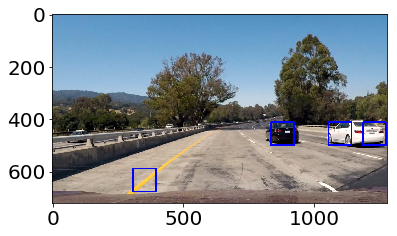

In [41]:
# L 32 search and classify
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import cv2
import glob
import time
from sklearn.svm import LinearSVC
from sklearn.preprocessing import StandardScaler,  RobustScaler
from skimage.feature import hog
from lesson_functions import *
# NOTE: the next import is only valid for scikit-learn version <= 0.17
# for scikit-learn >= 0.18 use:
# from sklearn.model_selection import train_test_split
from sklearn.cross_validation import train_test_split
# dlo
import pickle

def_global()
# turnable parameters, set at the beginning instead
'''
color_space = 'YCrCb' # Can be RGB, HSV, LUV, HLS, YUV, YCrCb
hist_feat = False
spatial_feat = False
hog_feat = True
orient = 12
overlap = (0.5, 0.5)
xywindow = (88, 88)
pix_per_cell = 8 # 16
hog_channel = 'ALL'
'''
show_global()

print ('Running search and classify ..... ')

car_features = extract_features_hog(cars, cspace=color_space, orient=orient, 
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, 
                        hog_channel=hog_channel)
notcar_features = extract_features_hog(notcars, cspace=color_space, orient=orient, 
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, 
                        hog_channel=hog_channel)
'''
car_features = extract_features_hog(cars, color_space=color_space, 
                        spatial_size=spatial_size, hist_bins=hist_bins, 
                        orient=orient, pix_per_cell=pix_per_cell, 
                        cell_per_block=cell_per_block, 
                        hog_channel=hog_channel, spatial_feat=spatial_feat, 
                        hist_feat=hist_feat, hog_feat=hog_feat)
notcar_features = extract_features_hog(notcars, color_space=color_space, 
                        spatial_size=spatial_size, hist_bins=hist_bins, 
                        orient=orient, pix_per_cell=pix_per_cell, 
                        cell_per_block=cell_per_block, 
                        hog_channel=hog_channel, spatial_feat=spatial_feat, 
                        hist_feat=hist_feat, hog_feat=hog_feat)
'''
X = np.vstack((car_features, notcar_features)).astype(np.float64)                        
# Fit a per-column scaler
X_scaler = RobustScaler().fit(X)
# Apply the scaler to X
scaled_X = X_scaler.transform(X)

# Define the labels vector
y = np.hstack((np.ones(len(car_features)), np.zeros(len(notcar_features))))


# Split up data into randomized training and test sets
rand_state = np.random.randint(0, 100)
X_train, X_test, y_train, y_test = train_test_split(
    scaled_X, y, test_size=0.2, random_state=rand_state)

print('Using:',orient,'orientations',pix_per_cell,
    'pixels per cell and', cell_per_block,'cells per block')
print('Feature vector length:', len(X_train[0]))
# Use a linear SVC 
svc = LinearSVC()
# Check the training time for the SVC
t=time.time()
svc.fit(X_train, y_train)
t2 = time.time()
print(round(t2-t, 2), 'Seconds to train SVC...')
# Check the score of the SVC
print('Test Accuracy of SVC = ', round(svc.score(X_test, y_test), 4))
# Check the prediction time for a single sample
t=time.time()

## dlo image = mpimg.imread('bbox-example-image.jpg')
image = mpimg.imread(trafficfile)
draw_image = np.copy(image)

# Uncomment the following line if you extracted training
# data from .png images (scaled 0 to 1 by mpimg) and the
# image you are searching is a .jpg (scaled 0 to 255)
#image = image.astype(np.float32)/255

### dlo 3/7/17 use 128,128 
### windows = slide_window(image, x_start_stop=[None, None], y_start_stop=y_start_stop, 
###                    xy_window=(96, 96), xy_overlap=overlap)
windows = slide_window(image, x_start_stop=[None, None], y_start_stop=y_start_stop, 
                    xy_window=xywindow, xy_overlap=overlap)



hot_windows = search_windows(image, windows, svc, X_scaler, color_space=color_space, 
                        spatial_size=spatial_size, hist_bins=hist_bins, 
                        orient=orient, pix_per_cell=pix_per_cell, 
                        cell_per_block=cell_per_block, 
                        hog_channel=hog_channel, spatial_feat=spatial_feat, 
                        hist_feat=hist_feat, hog_feat=hog_feat)                       

window_img = draw_boxes(draw_image, hot_windows, color=(0, 0, 255), thick=6)                    
print ('image shape :',window_img.shape)
plt.imshow(window_img)

box_list = hot_windows

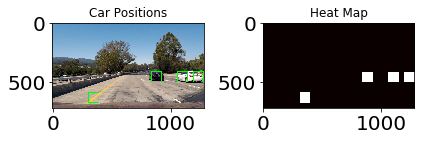

In [42]:
# L 35  Visualize heat map.  Multiple Detections & False Positives
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import pickle
import cv2
from scipy.ndimage.measurements import label

# Read in a pickle file with bboxes saved
# Each item in the "all_bboxes" list will contain a 
# list of boxes for one of the images shown above
## dlo box_list = pickle.load( open( "bbox_pickle.p", "rb" ))
'''
box_list_dict = pickle.load( open( "resources/bbox_pickle.p", "rb" ))
## dlo add
box_list = bbox_pickle["bboxes"]
'''
# Read in image similar to one shown above 
image = mpimg.imread(trafficfile)
heat = np.zeros_like(image[:,:,0]).astype(np.float)

def add_heat(heatmap, bbox_list):
    # Iterate through list of bboxes
    for box in bbox_list:
        # Add += 1 for all pixels inside each bbox
        # Assuming each "box" takes the form ((x1, y1), (x2, y2))
        heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1

    # Return updated heatmap
    return heatmap# Iterate through list of bboxes
    
def apply_threshold(heatmap, threshold):
    # Zero out pixels below the threshold
    heatmap[heatmap <= threshold] = 0
    # Return thresholded map
    return heatmap

def draw_labeled_bboxes(img, labels):
    # Iterate through all detected cars
    for car_number in range(1, labels[1]+1):
        # Find pixels with each car_number label value
        nonzero = (labels[0] == car_number).nonzero()
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Define a bounding box based on min/max x and y
        bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
        # Draw the box on the image
        cv2.rectangle(img, bbox[0], bbox[1], (0,255,0), 6)
    # Return the image
    return img

# Add heat to each box in box list
heat = add_heat(heat,box_list)
threshold = 0.5
# Apply threshold to help remove false positives
heat = apply_threshold(heat,threshold)

# Visualize the heatmap when displaying    
heatmap = np.clip(heat, 0, 255)

# Find final boxes from heatmap using label function
labels = label(heatmap)
draw_img = draw_labeled_bboxes(np.copy(image), labels)

fig = plt.figure()
plt.subplot(121)
plt.imshow(draw_img)
plt.title('Car Positions')
plt.subplot(122)
plt.imshow(heatmap, cmap='hot')
plt.title('Heat Map')
fig.tight_layout()


In [43]:
# begin testing with test images  #####################

In [44]:
############################
# define more function for video processing
def find_windows(img):
    draw_image = np.copy(img)
    heat = np.zeros_like(img[:,:,0]).astype(np.float)
# Uncomment the following line if you extracted training
# data from .png images (scaled 0 to 1 by mpimg) and the
# image you are searching is a .jpg (scaled 0 to 255)
#image = image.astype(np.float32)/255
    windows = slide_window(img, x_start_stop=[None, None], y_start_stop=y_start_stop, 
                    xy_window=xywindow, xy_overlap=(0.5, 0.5))

    hot_windows = search_windows(img, windows, svc, X_scaler, color_space=color_space, 
                        spatial_size=spatial_size, hist_bins=hist_bins, 
                        orient=orient, pix_per_cell=pix_per_cell, 
                        cell_per_block=cell_per_block, 
                        hog_channel=hog_channel, spatial_feat=spatial_feat, 
                        hist_feat=hist_feat, hog_feat=hog_feat)                       

    window_img = draw_boxes(draw_image, hot_windows, color=(0, 0, 255), thick=6)
    box_list = hot_windows
    # Add heat to each box in box list
    heat = add_heat(heat,box_list)
##    print('threshold', threshold)
# Apply threshold to help remove false positives
    heat = apply_threshold(heat,threshold)

# Visualize the heatmap when displaying    
    heatmap = np.clip(heat, 0, 255)

# Find final boxes from heatmap using label function
    labels = label(heatmap)
    draw_img = draw_labeled_bboxes(window_img, labels)
    return draw_img

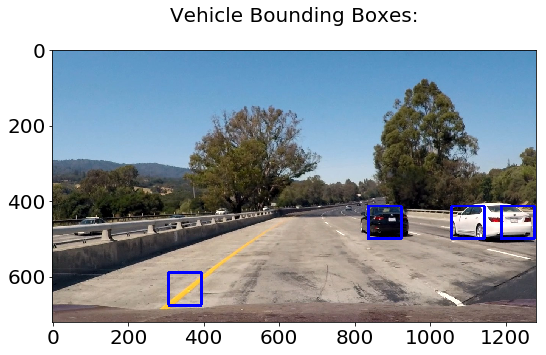

In [45]:
###############################################
# draw box after thresholding
def draw_labeled_bboxes(img, labels):
    # Iterate through all detected cars
    for car_number in range(1, labels[1]+1):
        # Find pixels with each car_number label value
        nonzero = (labels[0] == car_number).nonzero()
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Define a bounding box based on min/max x and y
        bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
        # Draw the box on the image
        cv2.rectangle(img, bbox[0], bbox[1], (0,0,255), 6)
    # Return the image
    return img

img = mpimg.imread(trafficfile)
draw_img = np.copy(img)
draw_img = draw_labeled_bboxes(draw_img, labels)

f = plt.figure(figsize=(20, 5))
plt.rc('xtick', labelsize=20) 
plt.rc('ytick', labelsize=20)
plt.imshow(draw_img)
plt.title('Vehicle Bounding Boxes:\n', fontsize=20);

In [46]:
##########################################
# define process image function
def process_vimage(imagefilename):
    img = mpimg.imread(imagefilename)
    # find windowns
##    labels = find_windows(img)
##    draw_img = np.copy(img)
    final_img = find_windows(img)
    # draw windows on image

##    draw_img = draw_labeled_bboxes(draw_img, labels)

    f = plt.figure(figsize=(20, 5))
    plt.rc('xtick', labelsize=20) 
    plt.rc('ytick', labelsize=20)
    plt.imshow(final_img)
    plt.title('Vehicle Bounding Boxes:\n', fontsize=20);

*** global parameters

spatial_size (32, 32)
pix_per_cell 8
spatial 32
histbin 32
hist_bins 32
orient 12
cell_per_block 2
hog_channel ALL
spatial_feat False
hist_feat False
hog_feat True
y_start_stop [368, 720]
overlap (0.5, 0.5)
color_space YCrCb
xywindow (88, 88)
threshold 0.5
len(cars) 8792
{len(notcars)} 8968 



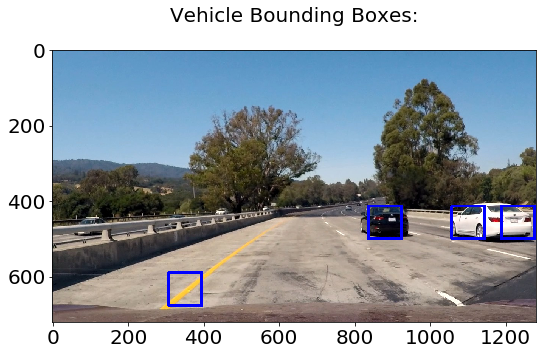

In [48]:
## show orginal and boxed imagea
show_global()
process_vimage("test_images/test1.jpg")

*** global parameters

spatial_size (32, 32)
pix_per_cell 8
spatial 32
histbin 32
hist_bins 32
orient 12
cell_per_block 2
hog_channel ALL
spatial_feat False
hist_feat False
hog_feat True
y_start_stop [368, 720]
overlap (0.5, 0.5)
color_space YCrCb
xywindow (88, 88)
threshold 0.5
len(cars) 8792
{len(notcars)} 8968 



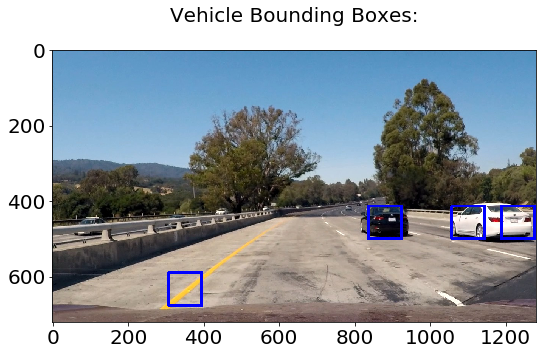

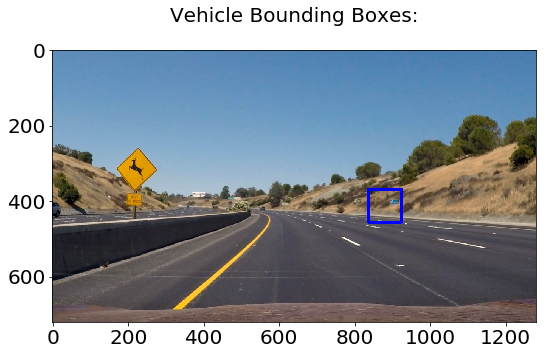

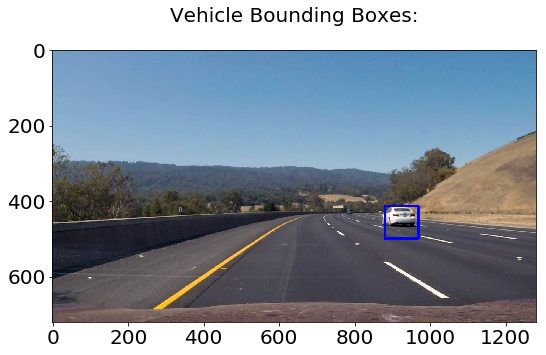

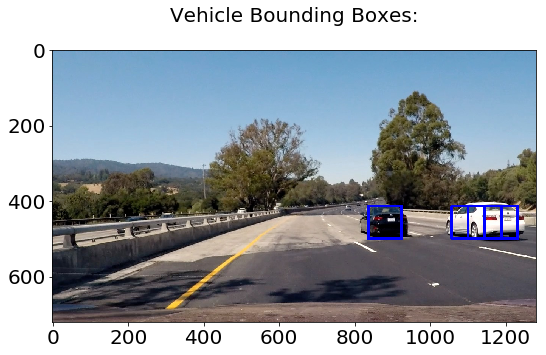

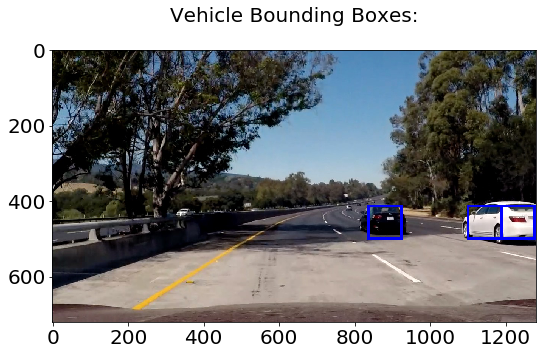

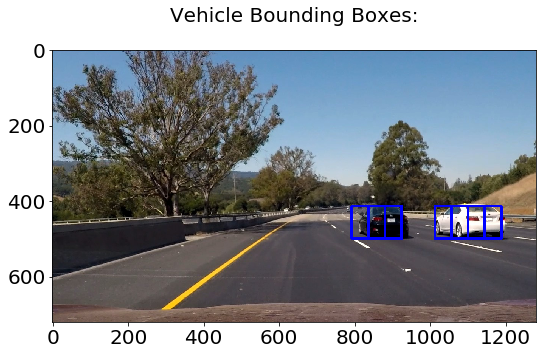

In [49]:
## show orginal and boxed imagea
show_global()
process_vimage("test_images/test1.jpg")
process_vimage("test_images/test2.jpg")
process_vimage("test_images/test3.jpg")
process_vimage("test_images/test4.jpg")
process_vimage("test_images/test5.jpg")
process_vimage("test_images/test6.jpg")

In [50]:
# define functions to remvoe false positive boxes
########################################################
def draw_labeled_bboxes_new(labels, heatmap,img=None):
    # Iterate through all detected cars
    b_heat=[] #((x1,y1),(x2,y2))

    for car_number in range(1, labels[1]+1):
        # Find pixels with each car_number label value
        nonzero = (labels[0] == car_number).nonzero()
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Define a bounding box based on min/max x and y
        bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
        highv = np.sum(heatmap[np.min(nonzeroy):np.max(nonzeroy), np.min(nonzerox):np.max(nonzerox)])


        # Draw the box on the image
        if not img is None:
            cv2.rectangle(img, bbox[0], bbox[1], (0,0,200), 3)

        b_heat.append(((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy))))

    # Return the image
    if not img is None:
        return img,b_heat
    else:
        return b_heat

#######################################################
def heatmap1(image,box_list,threshold=1, showImg = True):
    heat = np.zeros_like(image[:,:,0]).astype(np.float)
    # Add heat to each box in box list
    heat = add_heat(heat,box_list)

    # Apply threshold to help remove false positives
    heat = apply_threshold(heat,threshold)

    # Visualize the heatmap when displaying
    heatmap = np.clip(heat, 0, 255)

    # Find final boxes from heatmap using label function
    labels = label(heatmap)


    if showImg ==  True:
        draw_img,lbl_heat = draw_labeled_bboxes_new( labels,heatmap,np.copy(image))
        return draw_img, heatmap,lbl_heat
    else:
        lbl_heat = draw_labeled_bboxes_new(labels,heatmap)
        return heatmap,lbl_heat


#######################################################
def find_windows_new(img):
    draw_image = np.copy(img)
###    heat = np.zeros_like(img[:,:,0]).astype(np.float)
# Uncomment the following line if you extracted training
# data from .png images (scaled 0 to 1 by mpimg) and the
# image you are searching is a .jpg (scaled 0 to 255)
#image = image.astype(np.float32)/255
    windows = slide_window(img, x_start_stop=[None, None], y_start_stop=y_start_stop, 
                    xy_window=xywindow, xy_overlap=(0.5, 0.5))

    hot_windows = search_windows(img, windows, svc, X_scaler, color_space=color_space, 
                        spatial_size=spatial_size, hist_bins=hist_bins, 
                        orient=orient, pix_per_cell=pix_per_cell, 
                        cell_per_block=cell_per_block, 
                        hog_channel=hog_channel, spatial_feat=spatial_feat, 
                        hist_feat=hist_feat, hog_feat=hog_feat)                       

    window_img = draw_boxes(draw_image, hot_windows, color=(0, 0, 255), thick=6)
    return hot_windows
'''
    box_list = hot_windows
    # Add heat to each box in box list
    heat = add_heat(heat,box_list)
##    print('threshold', threshold)
# Apply threshold to help remove false positives
    heat = apply_threshold(heat,threshold)

# Visualize the heatmap when displaying    
    heatmap = np.clip(heat, 0, 255)

# Find final boxes from heatmap using label function
    labels = label(heatmap)
###    draw_img = draw_labeled_bboxes(window_img, labels)
    return labels
'''

#############################################################
def process_image_new(img):
    global counter
    global bbox_frames

    counter+=1
    countFrame = counter % nframes

    #Find rectangles for one image
    ### dlo bbox1 = find_cars_multiple(img, ystart, ystop, svc, orient, pix_per_cell, cell_per_block, spatial_size, hist_bins, cspace, X_scaler)
###    draw_img = np.copy(img)
###    img = np.asarray(img)
    bbox1 = find_windows_new(img)
    
    #Find heatmap single image
    thres = smooth_thres
    heat, bboxHeat = heatmap1(img,bbox1, thres, False)
    #print('bboxHeat',bboxHeat)

    #Store the rectangles of the frame
    bbox_frames[countFrame] = bboxHeat

    #Sum rectangles of the nframes
    bbox2=[]
    for box in bbox_frames:
        if box!=0:
            for b in box:
                bbox2.append(b)
    #print('bbox2',bbox2)

    #Find heatmap of average
    thres = smooth_average
    dimg, heat, bboxHeat2 = heatmap1(img,bbox2, thres, True)

    return dimg



In [51]:
show_global()

*** global parameters

spatial_size (32, 32)
pix_per_cell 8
spatial 32
histbin 32
hist_bins 32
orient 12
cell_per_block 2
hog_channel ALL
spatial_feat False
hist_feat False
hog_feat True
y_start_stop [368, 720]
overlap (0.5, 0.5)
color_space YCrCb
xywindow (88, 88)
threshold 0.5
len(cars) 8792
{len(notcars)} 8968 



In [52]:
####################################
# define global parameters to screen out false positive
def video_parm():
    global nframes, smooth_thres, smooth_average
    nframes = 5  #17 -25
    smooth_thres =0.5 # 1  
    smooth_average=1 # 5
    

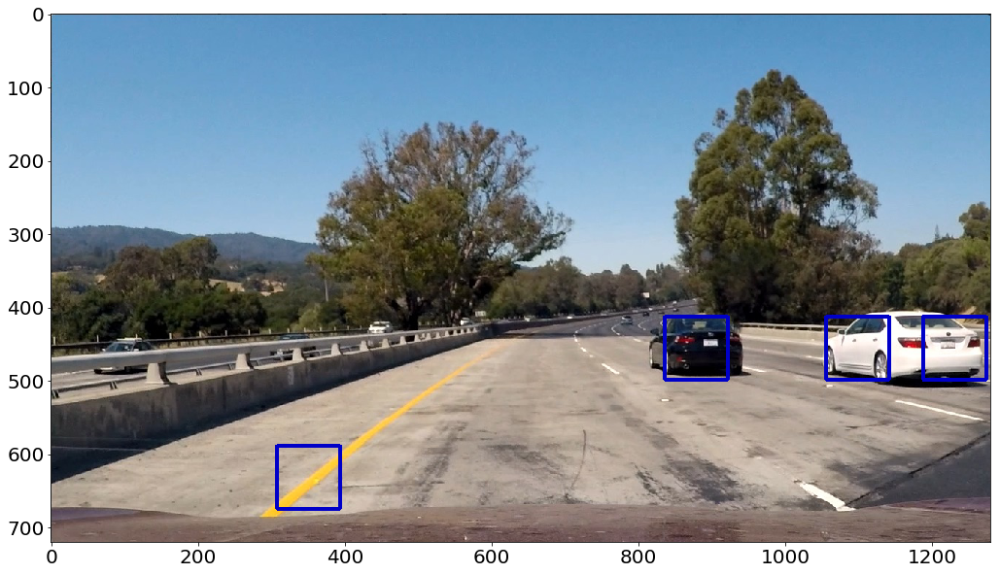

In [57]:
# plot a single image
# 
plt.figure(figsize=(25,10))
video_parm()
nframes = 1
smooth_thres = 0
smooth_average = 0

bbox_frames=[]
#Inicialization of list
for i in range(nframes):
    bbox_frames.append(0)

counter = 0
image = mpimg.imread(trafficfile)
(trafficfile)
img2 = process_image_new(image)
plt.imshow(img2)



In [58]:
############# new way

In [59]:
# process test video

In [1]:
import io
import base64
from IPython.display import HTML
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [ ]:
# peocess test video
#Create video file pipeline
# reset threshold for the video
video_parm()

bbox_frames=[]
#Inicialization of list 
for i in range(nframes):
    bbox_frames.append(0)
counter = 0
video_output = 'output_images/' + 'test_video_new.mp4'
clip1 = VideoFileClip('test_video.mp4')
video_clip = clip1.fl_image(process_image_new) #NOTE: this function expects color images!!
%time video_clip.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video output_images/test_video_new.mp4
[MoviePy] Writing video output_images/test_video_new.mp4


 97%|█████████▋| 38/39 [00:38<00:01,  1.12s/it]


In [2]:
###### . play_video ('project_video.mp4')
video_file = 'test_video_new.mp4'
video = io.open('output_images/' + video_file, 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
            <source src="data:video/mp4;base64,{0}" type="video/mp4" />
            </video>'''.format(encoded.decode('ascii')))

In [ ]:
# process project video
video_parm()

bbox_frames=[]
#Inicialization of list 
for i in range(nframes):
    bbox_frames.append(0)
counter = 0
video_output = 'output_images/' + 'project_video_new.mp4'
clip1 = VideoFileClip('project_video.mp4')
video_clip = clip1.fl_image(process_image_new) #NOTE: this function expects color images!!
%time video_clip.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video output_images/project_video_new.mp4
[MoviePy] Writing video output_images/project_video_new.mp4


 25%|██▍       | 312/1261 [04:34<15:20,  1.03it/s]

In [3]:
###### . play_video ('project_video.mp4')
video_file = 'project_video_new.mp4'
video = io.open('output_images/' + video_file, 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
            <source src="data:video/mp4;base64,{0}" type="video/mp4" />
            </video>'''.format(encoded.decode('ascii')))

### 3 d views of image pixels

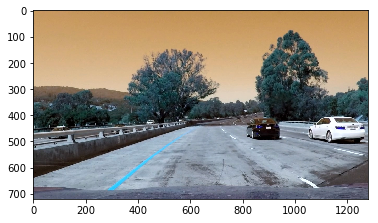

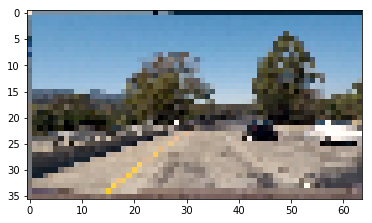

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

def plot3d(pixels, colors_rgb,
        axis_labels=list("RGB"), axis_limits=[(0, 255), (0, 255), (0, 255)]):
    """Plot pixels in 3D."""

    # Create figure and 3D axes
    fig = plt.figure(figsize=(8, 8))
    ax = Axes3D(fig)

    # Set axis limits
    ax.set_xlim(*axis_limits[0])
    ax.set_ylim(*axis_limits[1])
    ax.set_zlim(*axis_limits[2])

    # Set axis labels and sizes
    ax.tick_params(axis='both', which='major', labelsize=14, pad=8)
    ax.set_xlabel(axis_labels[0], fontsize=16, labelpad=16)
    ax.set_ylabel(axis_labels[1], fontsize=16, labelpad=16)
    ax.set_zlabel(axis_labels[2], fontsize=16, labelpad=16)

    # Plot pixel values with colors given in colors_rgb
    ax.scatter(
        pixels[:, :, 0].ravel(),
        pixels[:, :, 1].ravel(),
        pixels[:, :, 2].ravel(),
        c=colors_rgb.reshape((-1, 3)), edgecolors='none')

    return ax  # return Axes3D object for further manipulation


# Read a color image
## img = cv2.imread("000275.png")
img = cv2.imread("test_images/test1.jpg")

# Select a small fraction of pixels to plot by subsampling it
scale = max(img.shape[0], img.shape[1], 64) / 64  # at most 64 rows and columns
img_small = cv2.resize(img, (np.int(img.shape[1] / scale), np.int(img.shape[0] / scale)), interpolation=cv2.INTER_NEAREST)

# Convert subsampled image to desired color space(s)
img_small_RGB = cv2.cvtColor(img_small, cv2.COLOR_BGR2RGB)  # OpenCV uses BGR, matplotlib likes RGB
img_small_HSV = cv2.cvtColor(img_small, cv2.COLOR_BGR2HSV)
img_small_rgb = img_small_RGB / 255.  # scaled to [0, 1], only for plotting

plt.imshow(img)
plt.show()

plt.imshow(img_small_RGB)
plt.show()

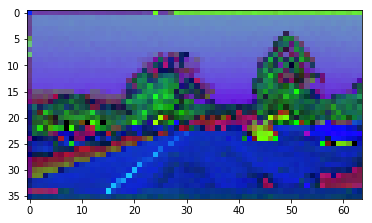

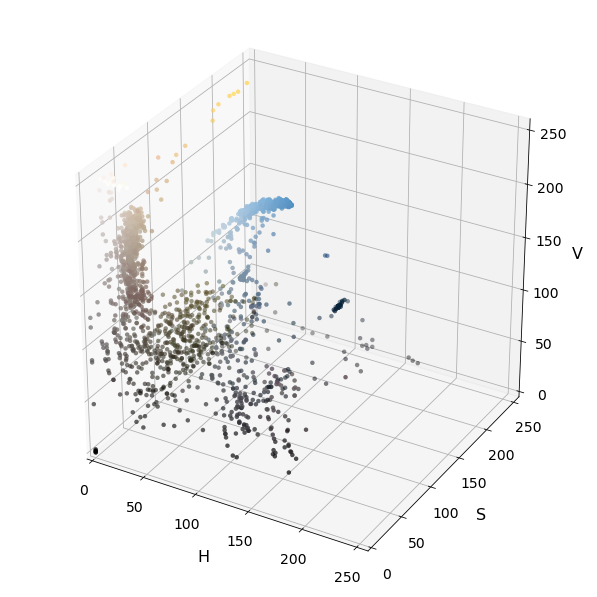

In [2]:
plt.imshow(img_small_HSV)

plot3d(img_small_HSV, img_small_rgb, axis_labels=list("HSV"))
plt.show()

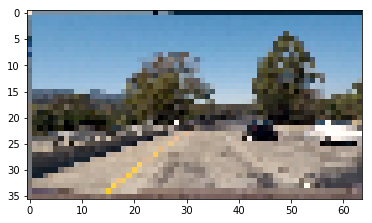

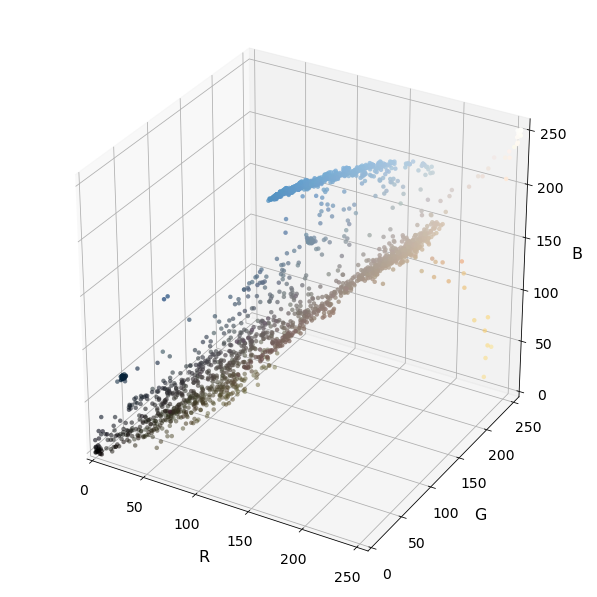

In [4]:
plt.imshow(img_small_rgb)

# Plot and show
plot3d(img_small_RGB, img_small_rgb)
plt.show()



## plot3d(img_small_HSV, img_small_rgb, axis_labels=list("HSV"))

## plt.show()

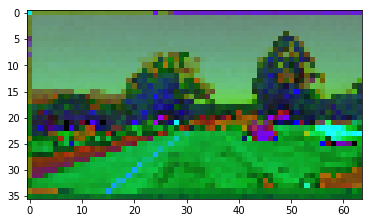

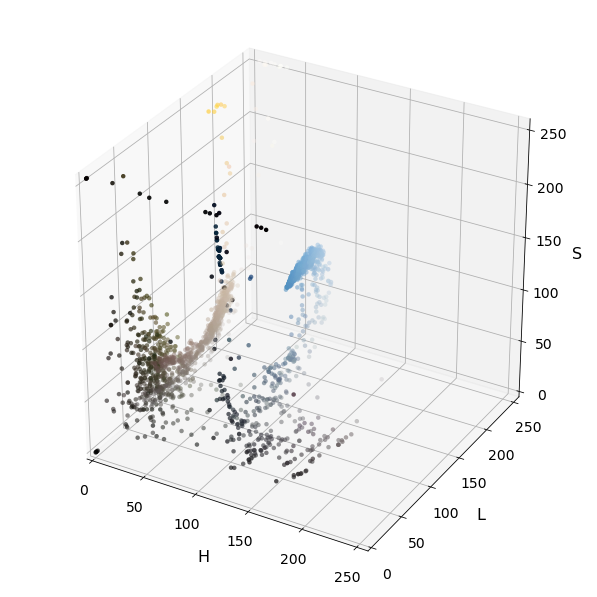

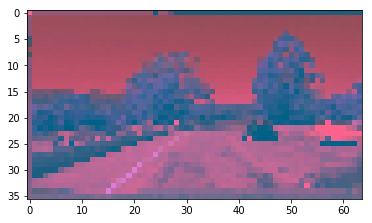

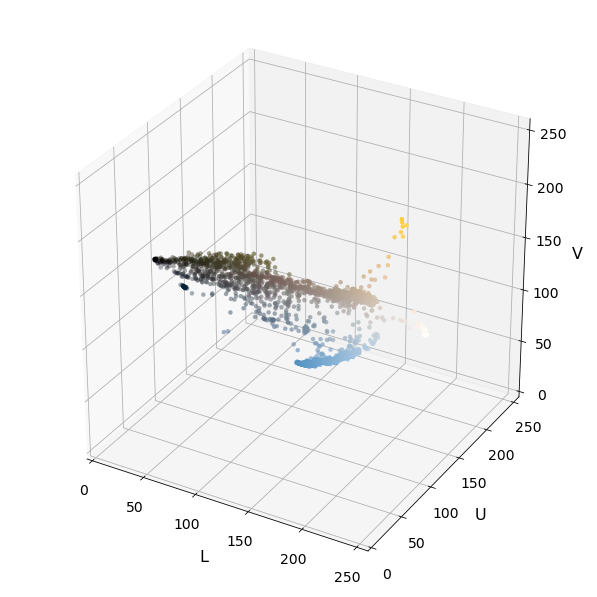

In [7]:
img_small_HLS = cv2.cvtColor(img_small, cv2.COLOR_BGR2HLS)  # OpenCV uses BGR, matplotlib likes RGB
img_small_LUV = cv2.cvtColor(img_small, cv2.COLOR_BGR2LUV)
plt.imshow(img_small_HLS)
plot3d(img_small_HLS, img_small_rgb, axis_labels=list("HLS"))
plt.show()
plt.imshow(img_small_LUV)
plot3d(img_small_LUV, img_small_rgb, axis_labels=list("LUV"))
plt.show()

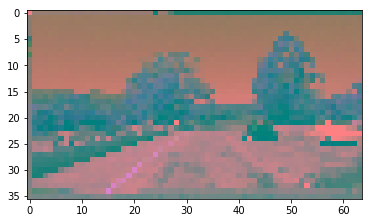

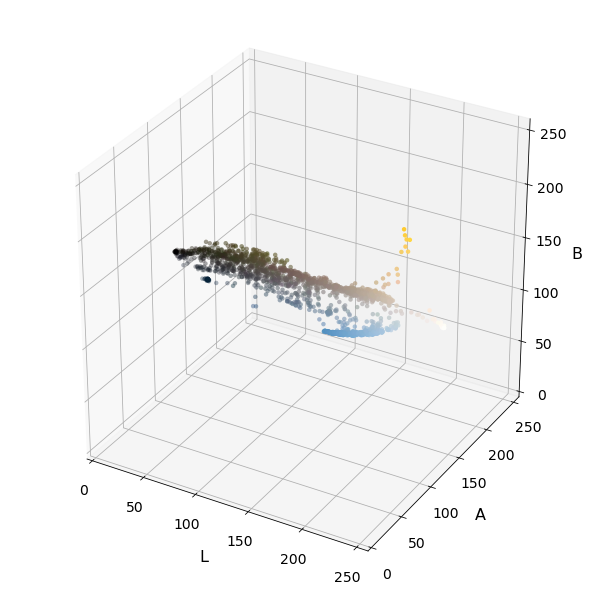

In [8]:
img_small_LAB = cv2.cvtColor(img_small, cv2.COLOR_BGR2LAB)  # OpenCV uses BGR, matplotlib likes RGB
plt.imshow(img_small_LAB)
plot3d(img_small_LAB, img_small_rgb, axis_labels=list("LAB"))
plt.show()